# __Finding ROI after applying spacing normalization__

## Import & config

In [1]:
%load_ext autoreload
%autoreload 2
import os
os.chdir('C:\\Users\\Usuario\\TFG\\digipanca\\')

In [16]:
import os
import numpy as np
import json
import nibabel as nib
from nibabel.processing import resample_from_to 
import src.data.transforms as transforms
from nibabel.orientations import apply_orientation
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from scipy.ndimage import zoom
from tqdm.notebook import tqdm
from nibabel.orientations import axcodes2ornt, io_orientation, ornt_transform, apply_orientation
from PIL import Image

In [3]:
data_dir = 'data/raw/train'
PATIENT_IDS = [p for p in os.listdir(data_dir)]
reorient = transforms.Orientation(('R', 'P', 'S'))
train_patients = PATIENT_IDS

In [4]:
extreme_values = {
    "pancreas": None,
    "tumor": None,
    "arteries": None,
    "veins": None
}

In [66]:
def apply_spacing_to_mask(image_nii, target_spacing=(1.,1.,1.)):
    # 1. Original spacing
    orig_spacing = image_nii.header.get_zooms()[:3]
    # 2. Zoom factors for scipy.zoom
    factors = np.array(orig_spacing) / np.array(target_spacing)
    # 3. Data
    img = image_nii.get_fdata().astype(np.int8)
    img_res = zoom(img, factors, order=0)

    # 4. Affine
    new_affine = image_nii.affine.copy()
    new_affine[0,0] = target_spacing[0]
    new_affine[1,1] = target_spacing[1]
    new_affine[2,2] = target_spacing[2]

    return img_res, new_affine
    
def apply_spacing_to_vol(image_nii, target_spacing=(1.,1.,1.)):
    # 1. Original spacing
    orig_spacing = image_nii.header.get_zooms()[:3]
    # 2. Zoom factors for scipy.zoom
    factors = np.array(orig_spacing) / np.array(target_spacing)
    # 3. Data
    img = image_nii.get_fdata().astype(np.float64)
    img_res = zoom(img, factors, order=1)

    # 4. Affine
    new_affine = image_nii.affine.copy()
    new_affine[0,0] = target_spacing[0]
    new_affine[1,1] = target_spacing[1]
    new_affine[2,2] = target_spacing[2]

    return img_res, new_affine

In [7]:
def apply_crop_pad(image, target_size):
    Hi, Wi, Di = image.shape
    target_height, target_width = target_size

    # --- Crop if bigger ---
    # Compute crop in H
    if Hi > target_height:
        start_i = (Hi - target_height) // 2
        end_i = start_i + target_height
    else:
        start_i = 0
        end_i = Hi

    # Compute crop in W
    if Wi > target_width:
        start_j = (Wi - target_width) // 2
        end_j = start_j + target_width
    else:
        start_j = 0
        end_j = Wi

    # Crop if needed
    image_cropped = image[start_i:end_i, start_j:end_j, :]

    # --- Padding if smaller ---
    Hi_c, Wi_c, _ = image_cropped.shape
    pad_h = target_height - Hi_c
    pad_w = target_width - Wi_c

    # Padding: (before, after) for H and W
    pad_h_before = pad_h // 2
    pad_h_after = pad_h - pad_h_before
    pad_w_before = pad_w // 2
    pad_w_after = pad_w - pad_w_before

    padding = (
        (pad_h_before, pad_h_after),
        (pad_w_before, pad_w_after),
        (0, 0)  # No padding in D
    )

    image_padded = np.pad(image_cropped, padding, mode='constant', constant_values=0)

    return image_padded

In [15]:
train_patients = tqdm(
    PATIENT_IDS,
    colour="red",
    leave=True
)
for patient_id in train_patients:
    image_path = os.path.join(data_dir, patient_id, "SEQ", f"CTport-{patient_id}.nii")
    mask_paths = {
        "pancreas": os.path.join(data_dir, patient_id, "SEG", f"Pancreas-{patient_id}.nii"),
        "tumor": os.path.join(data_dir, patient_id, "SEG", f"Tumor-{patient_id}.nii"),
        "arteries": os.path.join(data_dir, patient_id, "SEG", f"Arterias-{patient_id}.nii"),
        "veins": os.path.join(data_dir, patient_id, "SEG", f"Venas-{patient_id}.nii"),
    }

    image_nii = nib.load(image_path)

    _, transform = reorient(image_nii) # Reorient the image

    for structure, mask_path in mask_paths.items():
        if not os.path.exists(mask_path):
            print(f"⚠️ Warning: Mask {structure} not found for patient {patient_id}")
            continue

        mask_nii = nib.load(mask_path)
        if mask_nii.shape[2] != image_nii.shape[2]:
            print(f"\tresampling patient {patient_id}")
            mask_nii = resample_from_to(mask_nii, image_nii, order=0)

        # Apply spacing
        mask, _ = apply_spacing_to_mask(mask_nii, target_spacing=(.8,.8,1.))
        # mask = mask_nii.get_fdata().astype(np.int8)

        # Apply cropping or padding
        mask = apply_crop_pad(mask, target_size=(512,512))

        # Apply orientation transformation
        mask = apply_orientation(mask, transform)

        # Rotate the mask
        mask = np.rot90(mask, k=-1, axes=(0, 1))

        # Get coords
        coords = np.argwhere(mask > 0)  # Pixels with mask value

        if coords.size == 0:
            print(f"⚠️ Warning: Mask ({structure}) is empty for patient {patient_id}")
            continue  # Skip empty masks

        min_h, min_w, min_d = coords.min(axis=0)  # Min H, W, D
        max_h, max_w, max_d = coords.max(axis=0)  # Min H, W, D

        # Initialize for first time
        if extreme_values[structure] is None:
            extreme_values[structure] = {
                "min_h": min_h, "max_h": max_h,
                "min_w": min_w, "max_w": max_w,
                "min_d": min_d, "max_d": max_d
            }
        else:
            # Update min and max
            extreme_values[structure]["min_h"] = min(extreme_values[structure]["min_h"], min_h)
            extreme_values[structure]["max_h"] = max(extreme_values[structure]["max_h"], max_h)
            extreme_values[structure]["min_w"] = min(extreme_values[structure]["min_w"], min_w)
            extreme_values[structure]["max_w"] = max(extreme_values[structure]["max_w"], max_w)
            extreme_values[structure]["min_d"] = min(extreme_values[structure]["min_d"], min_d)
            extreme_values[structure]["max_d"] = max(extreme_values[structure]["max_d"], max_d)

  0%|          | 0/88 [00:00<?, ?it/s]

In [18]:
print("\nGlobal extreme values for cropping (Ideal ROI):")
for structure, values in extreme_values.items():
    if values:
        print(f"{structure.capitalize()}: "
              f"H({values['min_h']} - {values['max_h']}), "
              f"W({values['min_w']} - {values['max_w']}), "
              f"D({values['min_d']} - {values['max_d']})")
    else:
        print(f"{structure.capitalize()}: No data.")


Global extreme values for cropping (Ideal ROI):
Pancreas: H(139 - 345), W(164 - 411), D(1 - 136)
Tumor: H(128 - 329), W(180 - 405), D(2 - 122)
Arteries: H(141 - 360), W(160 - 398), D(1 - 145)
Veins: H(125 - 359), W(162 - 405), D(1 - 141)


In [19]:
# Initialize global extremes
global_extremes = {
    "min_h": float("inf"), "max_h": float("-inf"),
    "min_w": float("inf"), "max_w": float("-inf"),
    "min_d": float("inf"), "max_d": float("-inf")
}

# Compute global extreme values
for structure, values in extreme_values.items():
    if values:
        global_extremes["min_h"] = min(global_extremes["min_h"], values["min_h"])
        global_extremes["max_h"] = max(global_extremes["max_h"], values["max_h"])
        global_extremes["min_w"] = min(global_extremes["min_w"], values["min_w"])
        global_extremes["max_w"] = max(global_extremes["max_w"], values["max_w"])
        global_extremes["min_d"] = min(global_extremes["min_d"], values["min_d"])
        global_extremes["max_d"] = max(global_extremes["max_d"], values["max_d"])

# Show final ROI
print("\nOPTIMAL ROI:")
print(f"\tH({global_extremes['min_h']} - {global_extremes['max_h']}) > range: {global_extremes['max_h']-global_extremes['min_h']}\n"
      f"\tW({global_extremes['min_w']} - {global_extremes['max_w']}) > range: {global_extremes['max_w']-global_extremes['min_w']}\n"
      f"\tD({global_extremes['min_d']} - {global_extremes['max_d']}) > range: {global_extremes['max_d']-global_extremes['min_d']}")


OPTIMAL ROI:
	H(125 - 360) > range: 235
	W(160 - 411) > range: 251
	D(1 - 145) > range: 144


# __Testing sizes__

In [22]:
# Crop parameters
h_min, h_max = 114, 370
w_min, w_max = 158, 414

### Functions

In [30]:
# Colormap and norm for visualization
cmap = mcolors.ListedColormap(['green', 'purple', 'red', 'blue'])
boundaries = [0.5, 1.5, 2.5, 3.5, 4.5]
norm = mcolors.BoundaryNorm(boundaries, cmap.N, clip=True)

def visualize_crop(image_path, slice_idx=50):
    # Load image
    image, tf = reorient(nib.load(image_path))
    image = nib.load(image_path)
    image, _ = apply_spacing_to_vol(image, target_spacing=(.8,.8,1.))
    image = apply_orientation(image, tf)
    image = apply_crop_pad(image, (512, 512))
    image = np.rot90(image, k=-1, axes=(0,1))

    # Select slice (D dimension)
    original_slice = image[:, :, slice_idx]

    # Crop image
    cropped_slice = original_slice[h_min:h_max, w_min:w_max]

    # Visualize
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Border box over the image
    axes[0].imshow(original_slice, cmap="gray")
    rect = plt.Rectangle((w_min, h_min), w_max-w_min, h_max-h_min,
                         linewidth=2, edgecolor='r', facecolor='none')
    axes[0].add_patch(rect)
    axes[0].set_title(f"Original ({original_slice.shape[0]}x{original_slice.shape[1]})")

    # Cropped image
    axes[1].imshow(cropped_slice, cmap="gray")
    axes[1].set_title(f"Cropped ({cropped_slice.shape[0]}x{cropped_slice.shape[1]})")

    plt.show()

def load_combined_mask(patient_dir, slice_idx):
    patient_id = os.path.basename(os.path.normpath(patient_dir))
    mask_paths = {
        "pancreas": os.path.join(patient_dir, "SEG", f"Pancreas-{patient_id}.nii"),
        "tumor": os.path.join(patient_dir, "SEG", f"Tumor-{patient_id}.nii"),
        "arteries": os.path.join(patient_dir, "SEG", f"Arterias-{patient_id}.nii"),
        "veins": os.path.join(patient_dir, "SEG", f"Venas-{patient_id}.nii"),
    }

    # Initialize mask
    sample_mask, tf = reorient(nib.load(mask_paths["pancreas"]))
    sample_mask = nib.load(mask_paths["pancreas"])
    sample_mask, _ = apply_spacing_to_mask(sample_mask, target_spacing=(.8,.8,1.))
    sample_mask = apply_orientation(sample_mask, tf)
    sample_mask = apply_crop_pad(sample_mask, (512, 512))
    mask = np.zeros(sample_mask.shape, dtype=np.uint8)

    # Assign class values
    for i, (_, path) in enumerate(mask_paths.items(), start=1):
        mask_data = nib.load(path)
        mask_data, _ = apply_spacing_to_mask(mask_data, target_spacing=(.8,.8,1.))
        mask_data = apply_orientation(mask_data, tf)
        mask_data = apply_crop_pad(mask_data, (512, 512))
        mask_data = np.rot90(mask_data, k=-1, axes=(0,1))
        mask[mask_data > 0] = i  # 1 (pancreas), 2 (tumor)...

    return mask[:, :, slice_idx]

def visualize_crop_with_mask(patient_dir, slice_idx=50):
    patient_id = os.path.basename(os.path.normpath(patient_dir))
    image_path = os.path.join(patient_dir, "SEQ", f"CTport-{patient_id}.nii")

    # Load image and combined mask
    image, tf = reorient(nib.load(image_path))
    image = nib.load(image_path)
    image, _ = apply_spacing_to_vol(image, target_spacing=(.8,.8,1.))
    image = apply_orientation(image, tf)
    image = apply_crop_pad(image, (512, 512))
    image = np.rot90(image, k=-1, axes=(0,1))
    mask = load_combined_mask(patient_dir, slice_idx)

    # Select slice (D)
    original_slice = image[:, :, slice_idx]
    original_mask = mask

    # Crop image and mask
    cropped_slice = original_slice[h_min:h_max, w_min:w_max]
    cropped_mask = original_mask[h_min:h_max, w_min:w_max]

    # Prepare mask for overlay
    mask_overlay = np.where(original_mask > 0, original_mask, np.nan)
    cropped_mask_overlay = np.where(cropped_mask > 0, cropped_mask, np.nan)

    # Visualize
    fig, axes = plt.subplots(2, 2, figsize=(12, 12))

    # Border box over the image
    axes[0, 0].imshow(original_slice, cmap="gray")
    rect = plt.Rectangle((w_min, h_min), w_max-w_min, h_max-h_min,
                         linewidth=2, edgecolor='r', facecolor='none')
    axes[0, 0].add_patch(rect)
    axes[0, 0].set_title(f"Original Image ({original_slice.shape[0]}x{original_slice.shape[1]})")
    axes[0, 0].axis('off')

    # Original mask
    axes[0, 1].imshow(original_slice, cmap="gray")
    axes[0, 1].imshow(mask_overlay, cmap=cmap, norm=norm, alpha=0.6)
    axes[0, 1].set_title("Original Mask")
    axes[0, 1].axis('off')

    # Cropped image
    axes[1, 0].imshow(cropped_slice, cmap="gray")
    axes[1, 0].set_title(f"Cropped Image ({cropped_slice.shape[0]}x{cropped_slice.shape[1]})")
    axes[1, 0].axis('off')

    # Cropped mask
    axes[1, 1].imshow(cropped_slice, cmap="gray")
    axes[1, 1].imshow(cropped_mask_overlay, cmap=cmap, norm=norm, alpha=0.6)
    axes[1, 1].set_title("Cropped Mask")
    axes[1, 1].axis('off')

    # Add classes colorbar
    cbar_ax = fig.add_axes([0.92, 0.3, 0.02, 0.4])
    colorbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cbar_ax)
    colorbar.set_ticks([1, 2, 3, 4])
    colorbar.set_ticklabels(['Pancreas', 'Tumor', 'Arteries', 'Veins'])

    plt.show()

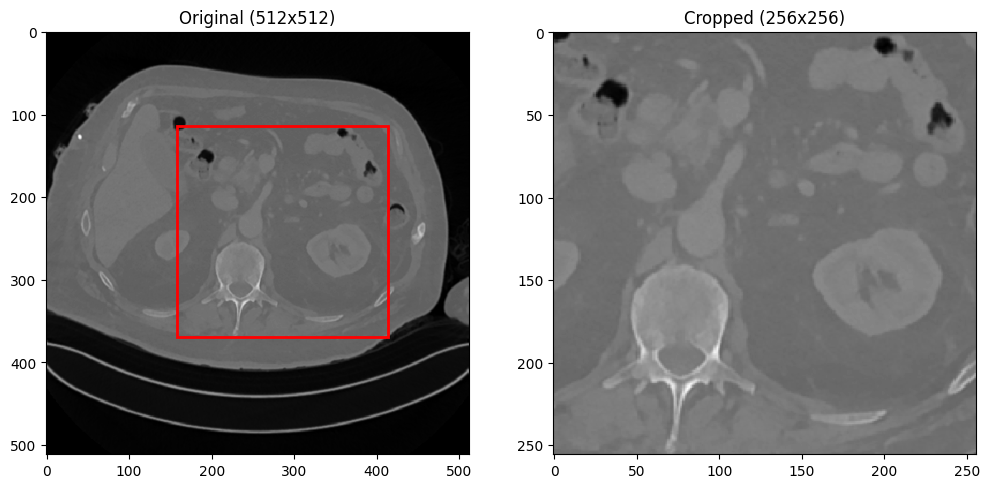

In [26]:
patient_id = 'rtum6'
sample_image_path = os.path.join(data_dir, patient_id, "SEQ", f"CTport-{patient_id}.nii")

visualize_crop(sample_image_path)

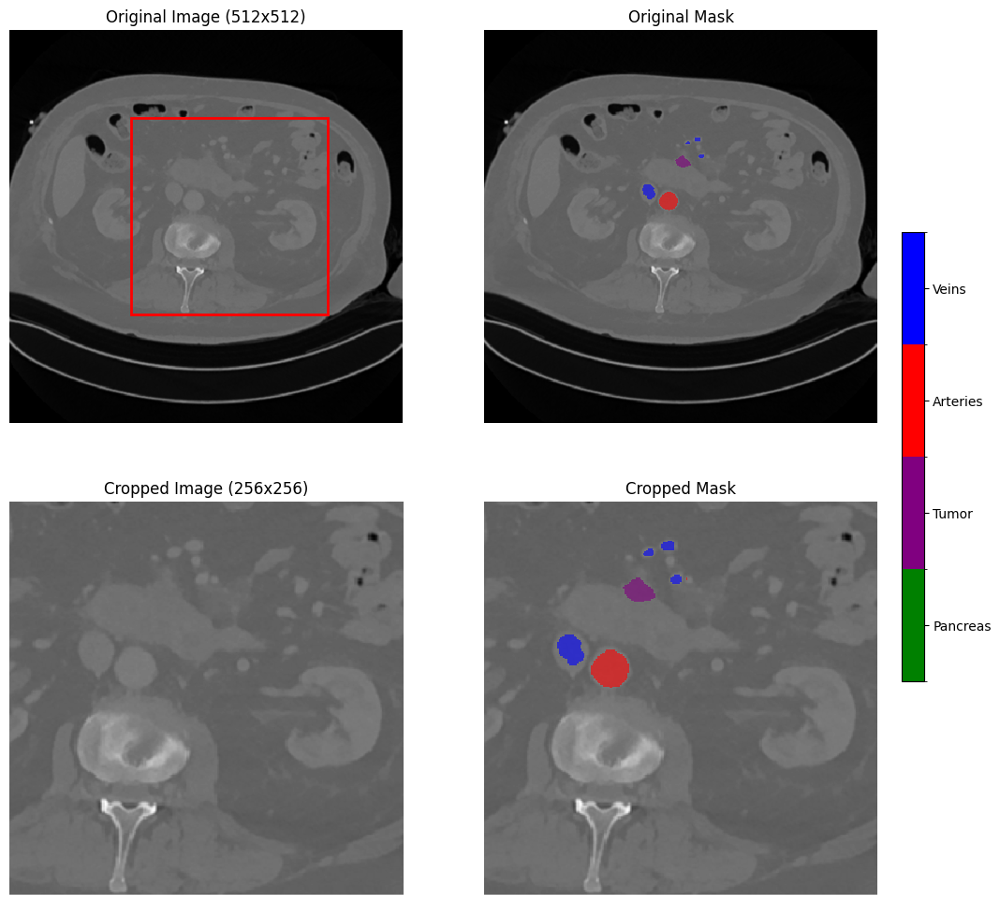

In [31]:
patient_id = 'rtum6'
sample_patient_dir = os.path.join(data_dir, patient_id)

# Visualize before and after cropping
visualize_crop_with_mask(sample_patient_dir, 10)

# __Count sacrificed pixels__

## _Functions_

In [40]:
def load_combined_mask(patient_dir):
    patient_id = os.path.basename(os.path.normpath(patient_dir))
    image_path = os.path.join(patient_dir, "SEQ", f"CTport-{patient_id}.nii")
    mask_paths = {
        1: os.path.join(patient_dir, "SEG", f"Pancreas-{patient_id}.nii"),
        2: os.path.join(patient_dir, "SEG", f"Tumor-{patient_id}.nii"),
        3: os.path.join(patient_dir, "SEG", f"Arterias-{patient_id}.nii"),
        4: os.path.join(patient_dir, "SEG", f"Venas-{patient_id}.nii"),
    }

    image_nii = nib.load(image_path)
    _, transform = reorient(image_nii)

    # Get the shape from the first mask
    first = nib.load(next(iter(mask_paths.values())))
    first, _ = apply_spacing_to_mask(first, target_spacing=(.8,.8,1.))
    first = apply_orientation(first, transform)
    first = apply_crop_pad(first, (512, 512))
    combined_mask = np.zeros(first.shape, dtype=np.uint8)

    # Load and combine masks
    for label, path in mask_paths.items():
        mask_nii = nib.load(path)
        if mask_nii.shape[2] != image_nii.shape[2]:
            mask_nii = resample_from_to(mask_nii, image_nii, order=0)

        mask_data, _ = apply_spacing_to_mask(mask_nii, target_spacing=(.8,.8,1.))
        mask_data = apply_orientation(mask_data, transform)
        mask_data = apply_crop_pad(mask_data, (512, 512))

        mask_data = (mask_data > 0).astype(np.uint8)  # Binarize
        mask_data = np.rot90(mask_data, k=-1, axes=(0,1))
        combined_mask[mask_data > 0] = label  # Assign label

    return combined_mask

def compute_pixel_loss(patients, data_dir):
    """
    Computes the number of sacrificed pixels due to cropping.

    Parameters:
    -----------
    patients : list
        List of patient IDs.
    data_dir : str
        Root directory containing patient data.

    Returns:
    --------
    pixel_loss : dict
        Dictionary with original, post-crop, and sacrificed pixel counts per class.
    """
    # Initialize global counters
    total_pixels_before = {i: 0 for i in range(0, 5)}
    total_pixels_after = {i: 0 for i in range(0, 5)}

    patients_loop = tqdm(
        patients,
        colour="red",
        leave=True
    )

    # Iterate through each patient
    for patient in patients_loop:
        patient_dir = os.path.join(data_dir, patient)
        
        # Load the full mask
        mask = load_combined_mask(patient_dir)

        # Count pixels per class before cropping
        unique, counts = np.unique(mask, return_counts=True)
        counts_before = dict(zip(unique, counts))

        # Apply cropping
        cropped_mask = mask[h_min:h_max, w_min:w_max, :]

        # Count pixels per class after cropping
        unique_crop, counts_crop = np.unique(cropped_mask, return_counts=True)
        counts_after = dict(zip(unique_crop, counts_crop))

        # Accumulate global counts
        for class_label in range(0, 5):
            total_pixels_before[class_label] += counts_before.get(class_label, 0)
            total_pixels_after[class_label] += counts_after.get(class_label, 0)

    # Compute sacrificed pixels
    pixel_loss = {
        class_label: {
            "original": total_pixels_before[class_label],
            "after_crop": total_pixels_after[class_label],
            "sacrificed": total_pixels_before[class_label] - total_pixels_after[class_label],
        }
        for class_label in range(0, 5)
    }

    return pixel_loss

def print_pixel_loss(pixel_loss):
    """
    Formats and prints the pixel loss results clearly.

    Parameters:
    -----------
    pixel_loss : dict
        Dictionary with original, post-crop, and sacrificed pixel counts per class.
    """
    class_names = {
        0: 'Background',
        1: 'Pancreas',
        2: 'Tumor',
        3: 'Arteries',
        4: 'Veins'
    }
    print("\n📊 OVERALL SACRIFICED PIXELS:\n")
    print(f"{'Class':<10}{'Original':>15}{'After Cropping':>25}{'Sacrificed':>15}")
    print("-" * 65)

    for class_label, values in pixel_loss.items():
        original = values["original"]
        after_crop = values["after_crop"]
        sacrificed = values["sacrificed"]

        print(f"{class_names[class_label]:<10}{original:>15,}{after_crop:>25,}{sacrificed:>15,}")

## _Count_

In [41]:
pixel_loss = compute_pixel_loss(PATIENT_IDS, data_dir)

  0%|          | 0/88 [00:00<?, ?it/s]

In [42]:
print_pixel_loss(pixel_loss)


📊 OVERALL SACRIFICED PIXELS:

Class            Original           After Cropping     Sacrificed
-----------------------------------------------------------------
Background  2,667,173,506              650,368,642  2,016,804,864
Pancreas        7,888,949                7,888,949              0
Tumor           1,387,650                1,387,650              0
Arteries        5,528,289                5,528,289              0
Veins           7,094,758                7,094,758              0


# __TEST__

In [64]:
def test_resampling(patient_id, data_dir, output_dir, target_spacing=(.8,.8,1.)):
    patient_dir = os.path.join(data_dir, patient_id)
    image_path = os.path.join(patient_dir, "SEQ", f"CTport-{patient_id}.nii")
    mask_paths = {
        1: os.path.join(patient_dir, "SEG", f"Pancreas-{patient_id}.nii"),
        2: os.path.join(patient_dir, "SEG", f"Tumor-{patient_id}.nii"),
        3: os.path.join(patient_dir, "SEG", f"Arterias-{patient_id}.nii"),
        4: os.path.join(patient_dir, "SEG", f"Venas-{patient_id}.nii"),
    }

    image_nii = nib.load(image_path)

    affine = image_nii.affine.copy()
    print(affine)

    image, _ = apply_spacing_to_vol(image_nii, target_spacing=target_spacing)
    image = apply_crop_pad(image, (512, 512))
    # image = image_nii.get_fdata().astype(np.float64)
    
    # affine = np.eye(4)
    for i in range(3):
        affine[i,i] = -target_spacing[i] if (affine[i,i]<0) else target_spacing[i]

    nifti_img = nib.Nifti1Image(image, affine)

    os.makedirs(output_dir, exist_ok=True)
    output_patient_dir = os.path.join(output_dir, patient_id)
    os.makedirs(output_patient_dir, exist_ok=True)

    vol_file = os.path.join(output_patient_dir, "vol.nii")
    nib.save(nifti_img, vol_file)

    names = ["pancreas.nii", "tumor.nii", "arteries.nii", "veins.nii"]

    # Load and combine masks
    for label, path in mask_paths.items():
        mask_nii = nib.load(path)
        affine = mask_nii.affine.copy()
        for i in range(3):
            affine[i,i] = -target_spacing[i] if (affine[i,i]<0) else target_spacing[i]
        
        mask_data, _ = apply_spacing_to_mask(mask_nii, target_spacing=target_spacing)
        mask_data = apply_crop_pad(mask_data, (512, 512))

        nifti_mask = nib.Nifti1Image(mask_data, affine)
        
        mask_file = os.path.join(output_patient_dir, names[label-1])
        nib.save(nifti_mask, mask_file)

In [67]:
test_resampling('rtum35', data_dir, 'data/resampled')

[[  -0.96875       0.            0.          248.        ]
 [   0.           -0.96875       0.          152.        ]
 [   0.            0.            2.01851845 -200.50010681]
 [   0.            0.            0.            1.        ]]


In [8]:
from src.data.preprocessing import (
    resample_volume_spacing,
    resample_mask_spacing,
    update_affine,
    crop_or_pad_to_size
)
IMAGES = []
def test_resampling_v2(patient_id, data_dir, output_dir, target_spacing=(.8,.8,1.)):
    patient_dir = os.path.join(data_dir, patient_id)
    image_path = os.path.join(patient_dir, "SEQ", f"CTport-{patient_id}.nii")
    mask_paths = {
        1: os.path.join(patient_dir, "SEG", f"Pancreas-{patient_id}.nii"),
        2: os.path.join(patient_dir, "SEG", f"Tumor-{patient_id}.nii"),
        3: os.path.join(patient_dir, "SEG", f"Arterias-{patient_id}.nii"),
        4: os.path.join(patient_dir, "SEG", f"Venas-{patient_id}.nii"),
    }

    image_nii = nib.load(image_path)
    affine = image_nii.affine

    print("Original Affine\n", affine)

    if target_spacing is not None:
        image = resample_volume_spacing(image_nii, target_spacing)
        image = crop_or_pad_to_size(image, (512, 512))  # Crop or pad to size
        affine = update_affine(affine, target_spacing)  # Update the affine matrix
        image, transform = reorient(image, affine)  # Reorient the image
    else:
        image, transform = reorient(image_nii) # Reorient the image

    image = np.rot90(image, k=-1, axes=rotation_axes)

    print("Updated Affine\n", affine)

    IMAGES.append(image[:, :, 50])

    nifti_img = nib.Nifti1Image(image, affine)

    os.makedirs(output_dir, exist_ok=True)
    output_patient_dir = os.path.join(output_dir, patient_id)
    os.makedirs(output_patient_dir, exist_ok=True)

    vol_file = os.path.join(output_patient_dir, "vol.nii")
    nib.save(nifti_img, vol_file)

    names = ["pancreas.nii", "tumor.nii", "arteries.nii", "veins.nii"]

    # Load and combine masks
    for label, path in mask_paths.items():
        mask_nii = nib.load(path)
        affine = mask_nii.affine
        
        if target_spacing is not None:
            mask = resample_mask_spacing(mask_nii, target_spacing)
            mask = crop_or_pad_to_size(mask, (512, 512))  # Crop or pad to size
            affine = update_affine(affine, target_spacing)  # Update the affine matrix

        # mask = apply_orientation(mask, transform)

        IMAGES.append(mask[:, :, 50])

        nifti_mask = nib.Nifti1Image(mask, affine)
        
        mask_file = os.path.join(output_patient_dir, names[label-1])
        nib.save(nifti_mask, mask_file)

In [9]:
test_resampling_v2('rtum35', data_dir, 'data/resampled')

Original Affine
 [[  -0.96875       0.            0.          248.        ]
 [   0.           -0.96875       0.          152.        ]
 [   0.            0.            2.01851845 -200.50010681]
 [   0.            0.            0.            1.        ]]
Updated Affine
 [[  -0.8           0.            0.          248.        ]
 [   0.           -0.8           0.          152.        ]
 [   0.            0.            1.         -200.50010681]
 [   0.            0.            0.            1.        ]]


In [10]:
IMAGES = []
def test_resampling_visual(patient_id, data_dir, target_spacing=(.8,.8,1.)):
    patient_dir = os.path.join(data_dir, patient_id)
    image_path = os.path.join(patient_dir, "SEQ", f"CTport-{patient_id}.nii")
    mask_paths = {
        1: os.path.join(patient_dir, "SEG", f"Pancreas-{patient_id}.nii"),
        2: os.path.join(patient_dir, "SEG", f"Tumor-{patient_id}.nii"),
        3: os.path.join(patient_dir, "SEG", f"Arterias-{patient_id}.nii"),
        4: os.path.join(patient_dir, "SEG", f"Venas-{patient_id}.nii"),
    }

    image_nii = nib.load(image_path)
    affine = image_nii.affine

    print("Original Affine\n", affine)

    if target_spacing is not None:
        image = resample_volume_spacing(image_nii, target_spacing)
        image = crop_or_pad_to_size(image, (512, 512))  # Crop or pad to size
        affine = update_affine(affine, target_spacing)  # Update the affine matrix
        image, transform = reorient(image, affine)  # Reorient the image
    else:
        image, transform = reorient(image_nii) # Reorient the image

    image = np.rot90(image, k=-1, axes=(0,1))

    print("Updated Affine\n", affine)

    IMAGES.append(image)

    # Load and combine masks
    masks = np.zeros_like(image)
    for label, path in mask_paths.items():
        mask_nii = nib.load(path)
        affine = mask_nii.affine
        
        if target_spacing is not None:
            mask = resample_mask_spacing(mask_nii, target_spacing)
            mask = crop_or_pad_to_size(mask, (512, 512))  # Crop or pad to size
            affine = update_affine(affine, target_spacing)  # Update the affine matrix

        mask = apply_orientation(mask, transform)
        mask = (mask > 0).astype(np.uint8)
        mask = np.rot90(mask, k=-1, axes=(0,1))

        masks[mask > 0] = label

    IMAGES.append(masks)

In [14]:
# Colormap and norm for visualization
cmap = mcolors.ListedColormap(['green', 'purple', 'red', 'blue'])
boundaries = [0.5, 1.5, 2.5, 3.5, 4.5]
norm = mcolors.BoundaryNorm(boundaries, cmap.N, clip=True)
def visualize_resampling_with_mask(image, mask):

    # Prepare mask for overlay
    mask_overlay = np.where(mask > 0, mask, np.nan)

    D = image.shape[2]

    for i in range(D):
        # Visualize
        fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    
        # Original
        axes[0].imshow(image[:, :, i], cmap='gray')
        axes[0].set_title(f'Original slice {i}')
        axes[0].axis('off')
    
        # Original mask
        axes[1].imshow(image[:, :, i], cmap="gray")
        axes[1].imshow(mask_overlay[:, :, i], cmap=cmap, norm=norm, alpha=0.8)
        axes[1].set_title("Original Mask")
        axes[1].axis('off')
    
        # Add classes colorbar
        cbar_ax = fig.add_axes([0.92, 0.3, 0.02, 0.4])
        colorbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cbar_ax)
        colorbar.set_ticks([1, 2, 3, 4])
        colorbar.set_ticklabels(['Pancreas', 'Tumor', 'Arteries', 'Veins'])
    
        plt.show()

In [12]:
test_resampling_visual('rtum35', data_dir)

Original Affine
 [[  -0.96875       0.            0.          248.        ]
 [   0.           -0.96875       0.          152.        ]
 [   0.            0.            2.01851845 -200.50010681]
 [   0.            0.            0.            1.        ]]
Updated Affine
 [[  -0.8           0.            0.          248.        ]
 [   0.           -0.8           0.          152.        ]
 [   0.            0.            1.         -200.50010681]
 [   0.            0.            0.            1.        ]]


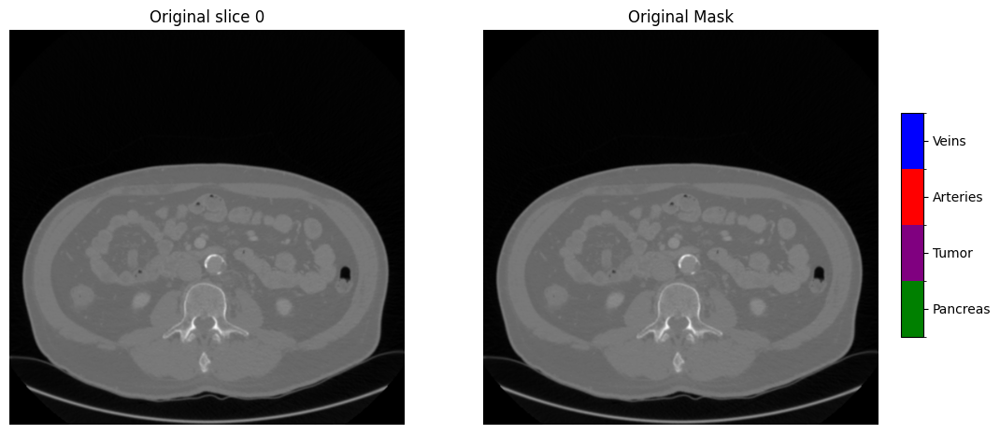

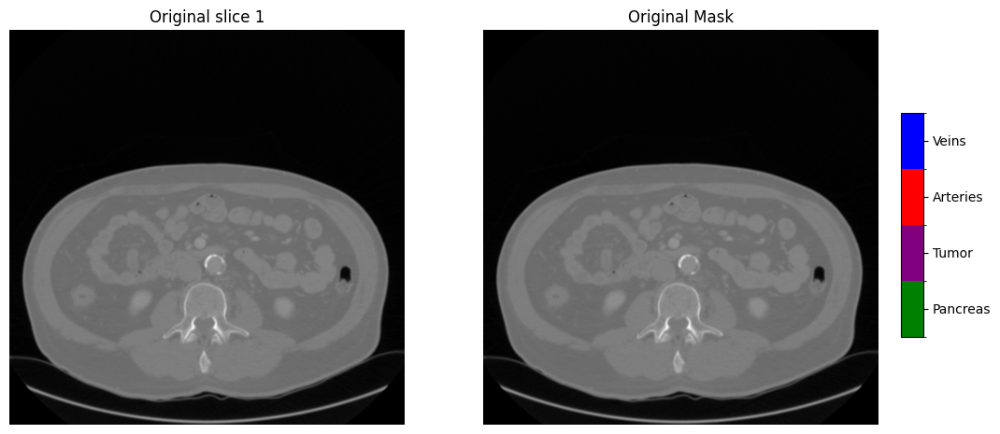

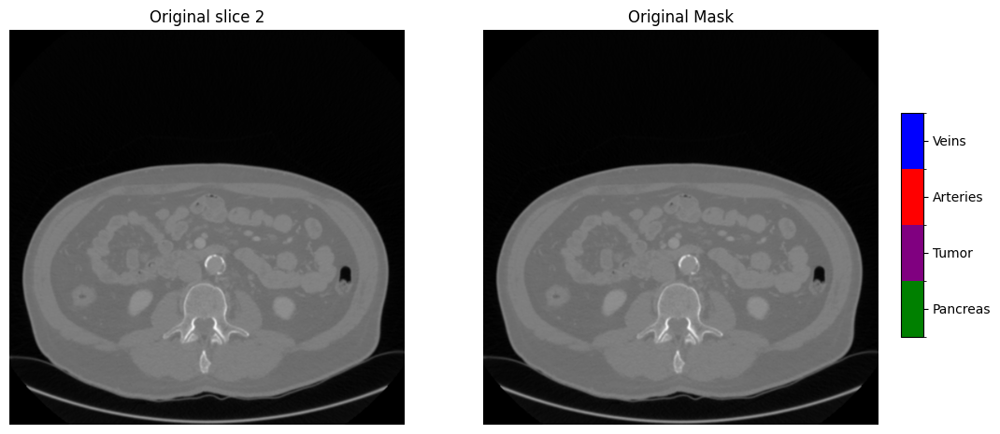

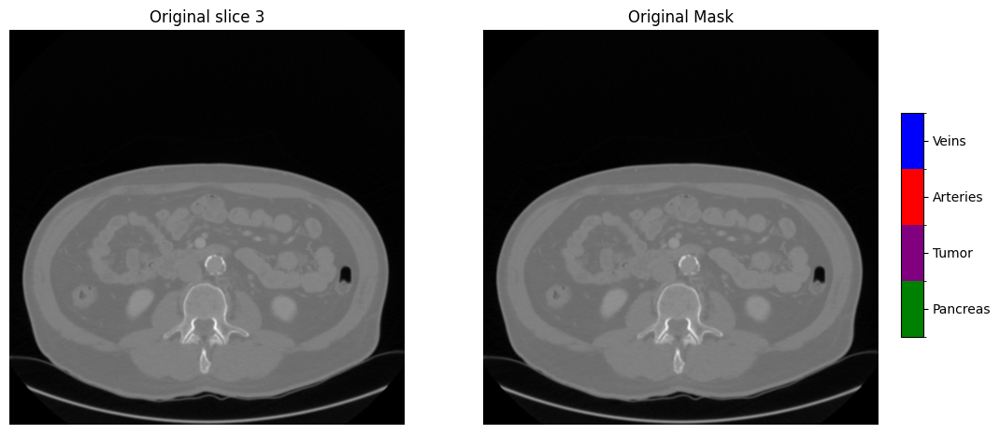

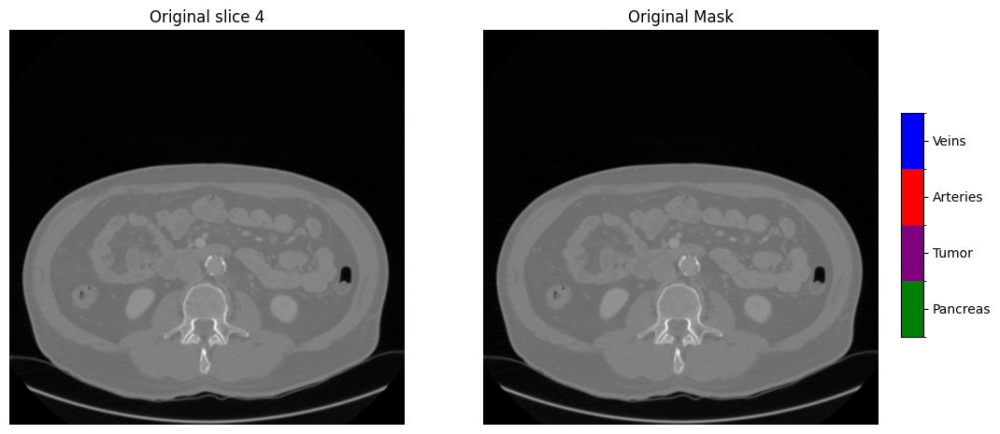

...

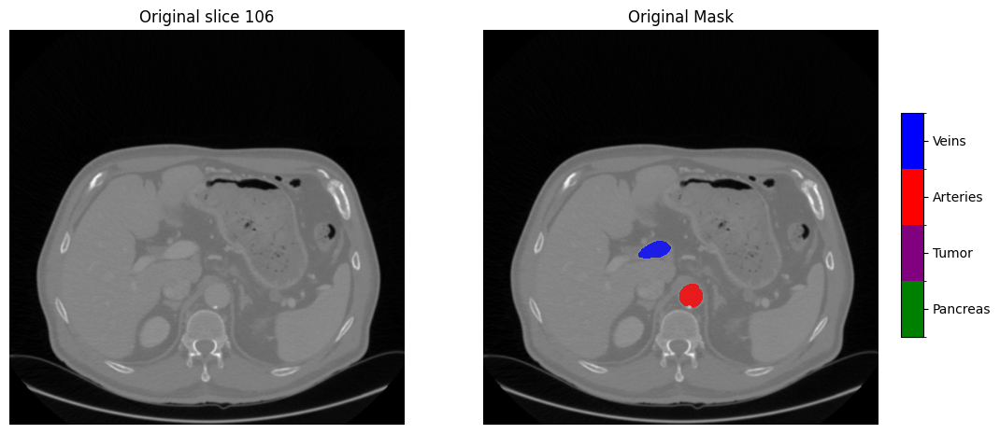

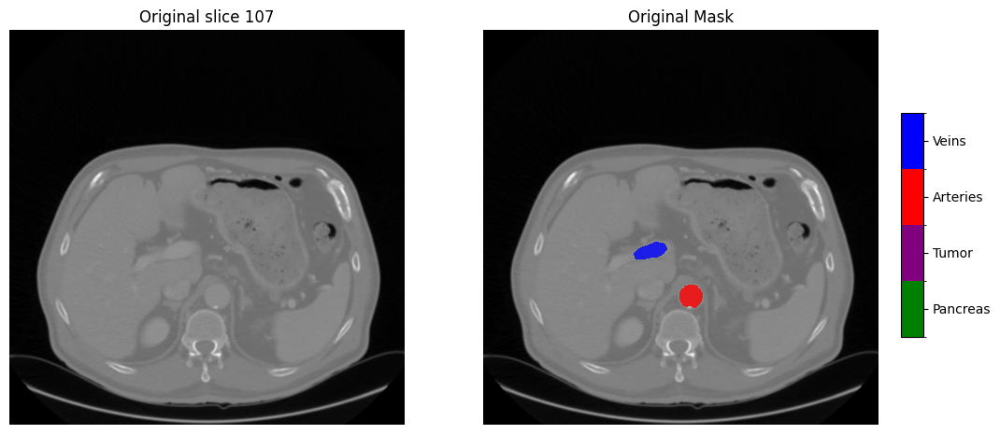

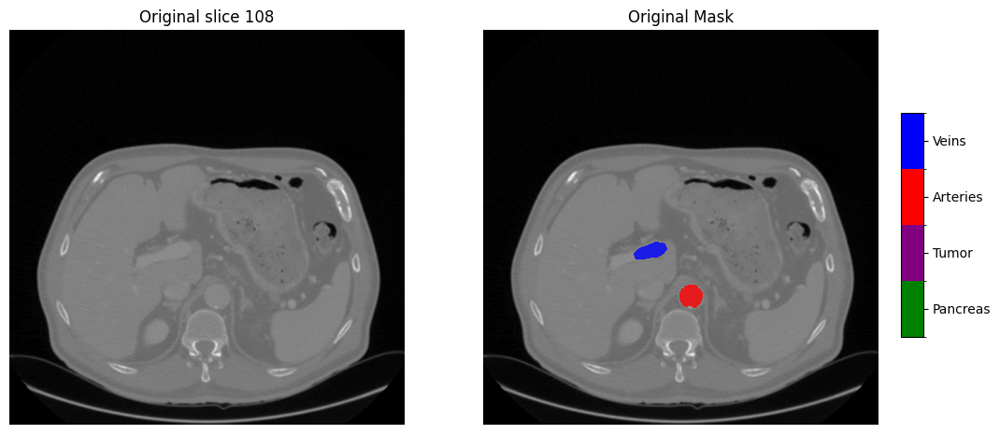

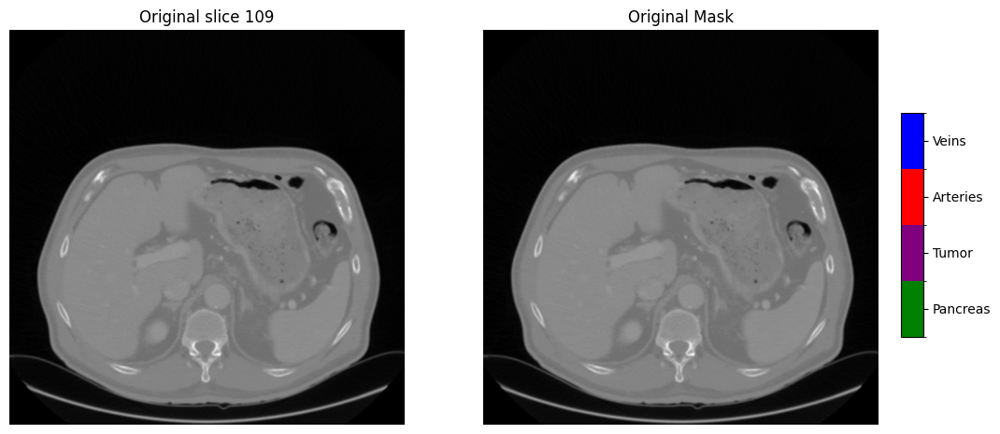

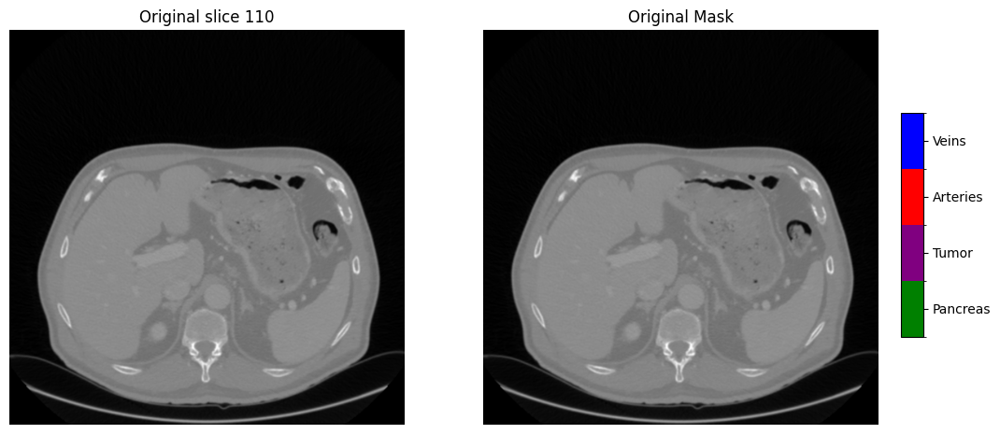

In [15]:
visualize_resampling_with_mask(IMAGES[0], IMAGES[1])

# __Test preprocessing.py__

In [4]:
from src.data.preprocessing import process_patient_2d

In [20]:
# Colormap and norm for visualization
cmap = mcolors.ListedColormap(['green', 'purple', 'red', 'blue'])
boundaries = [0.5, 1.5, 2.5, 3.5, 4.5]
norm = mcolors.BoundaryNorm(boundaries, cmap.N, clip=True)

def test_preprocessing(patient_id):
    patient_dir = os.path.join('data/raw/train', patient_id)
    output_dir = 'data/processed/2d_res/train/'
    process_patient_2d(patient_dir, output_dir, target_spacing=(.8,.8,1.), h_min=h_min, h_max=h_max, w_min=w_min, w_max=w_max)

    images = [os.path.join(output_dir, 'images', i) for i in os.listdir(os.path.join(output_dir, 'images'))]
    masks = [os.path.join(output_dir, 'masks', i) for i in os.listdir(os.path.join(output_dir, 'masks'))]

    for i, (img, msk) in enumerate(zip(images, masks)):
        image = np.load(img)
        mask = np.array(Image.open(msk).convert("L"))
        mask_overlay = np.where(mask > 0, mask, np.nan)

        # Visualize
        fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    
        # Original
        axes[0].imshow(image, cmap='gray')
        axes[0].set_title(f'Original slice {i}')
        axes[0].axis('off')
    
        # Original mask
        axes[1].imshow(image, cmap="gray")
        axes[1].imshow(mask_overlay, cmap=cmap, norm=norm, alpha=0.8)
        axes[1].set_title("Original Mask")
        axes[1].axis('off')
    
        # Add classes colorbar
        cbar_ax = fig.add_axes([0.92, 0.3, 0.02, 0.4])
        colorbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cbar_ax)
        colorbar.set_ticks([1, 2, 3, 4])
        colorbar.set_ticklabels(['Pancreas', 'Tumor', 'Arteries', 'Veins'])
    
        plt.show()

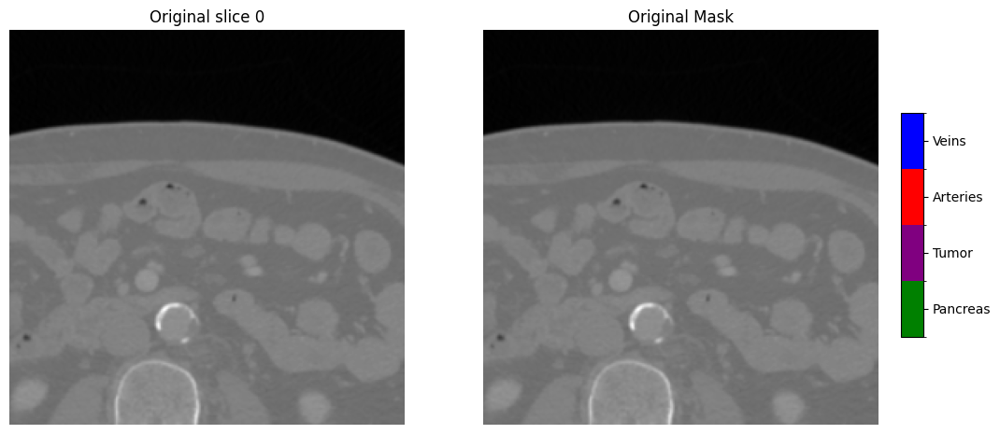

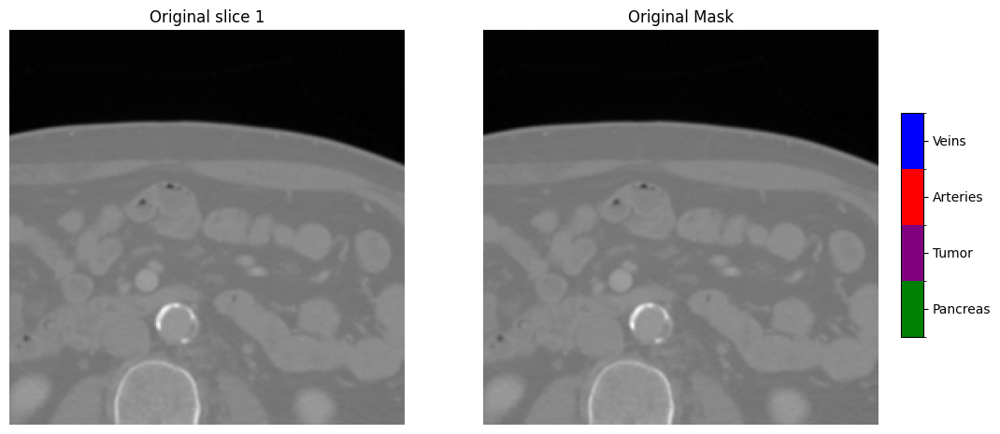

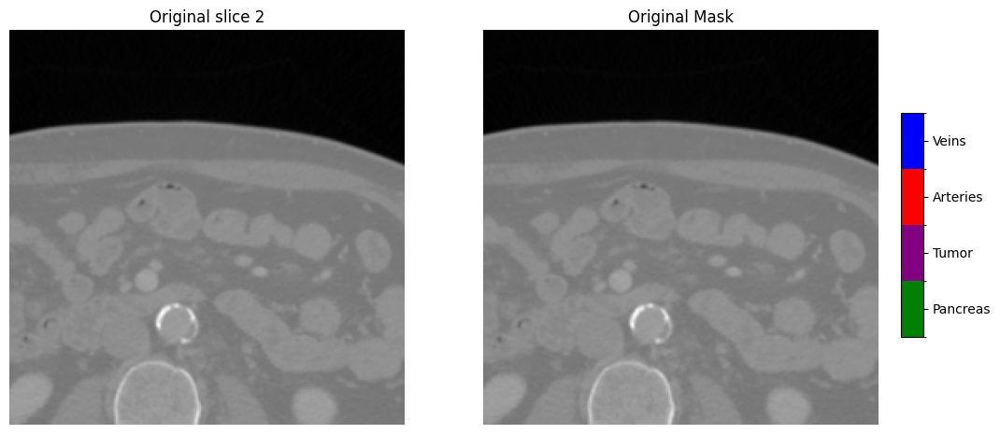

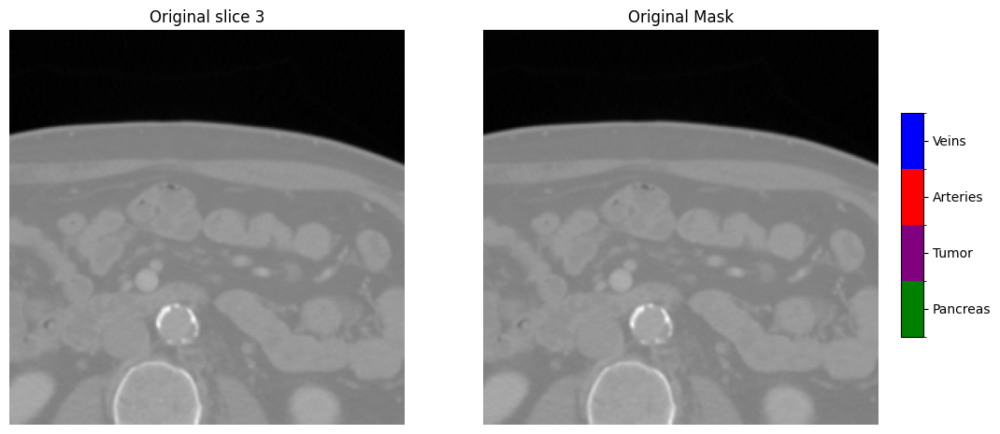

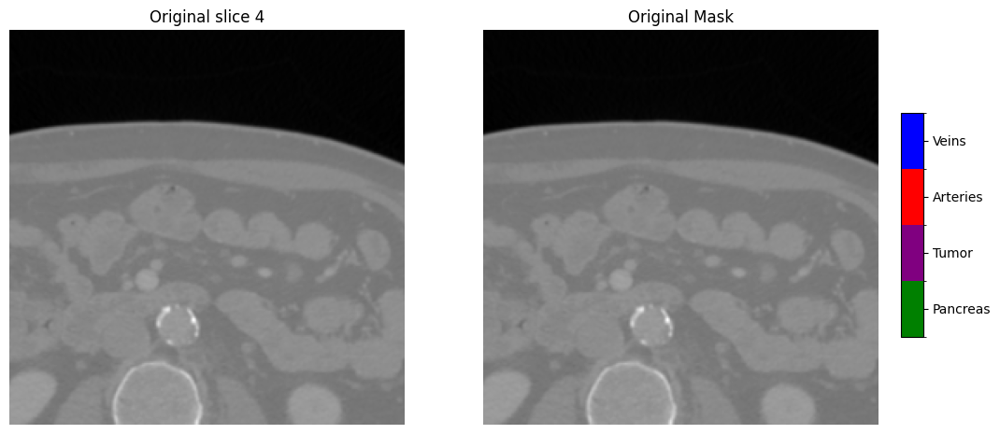

...

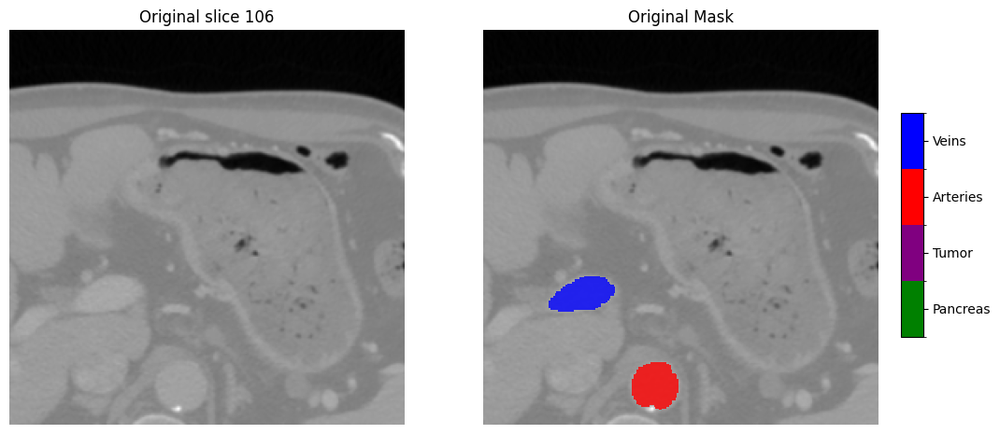

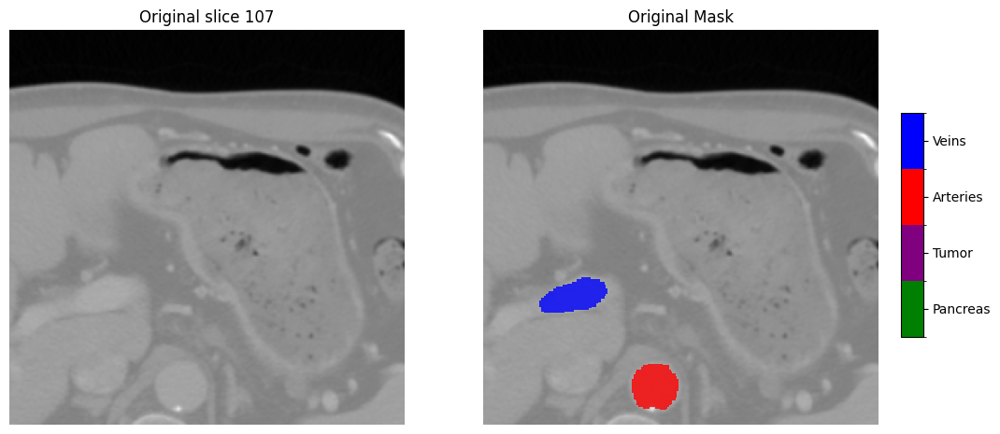

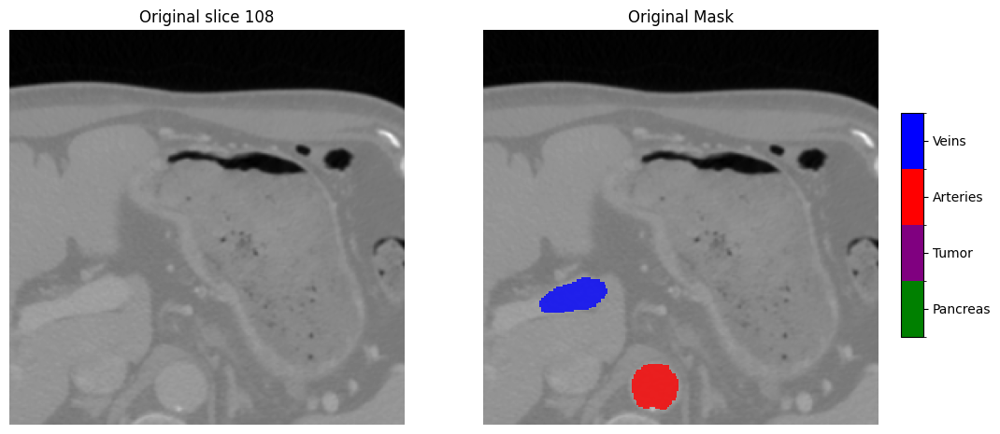

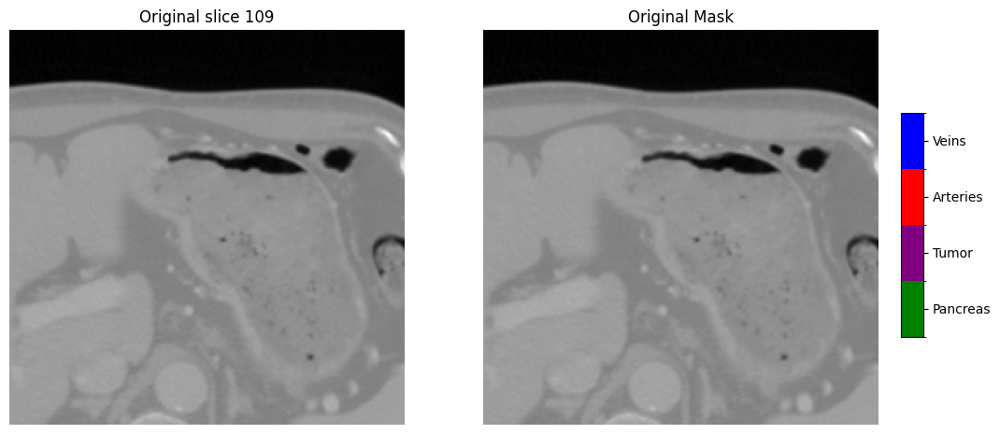

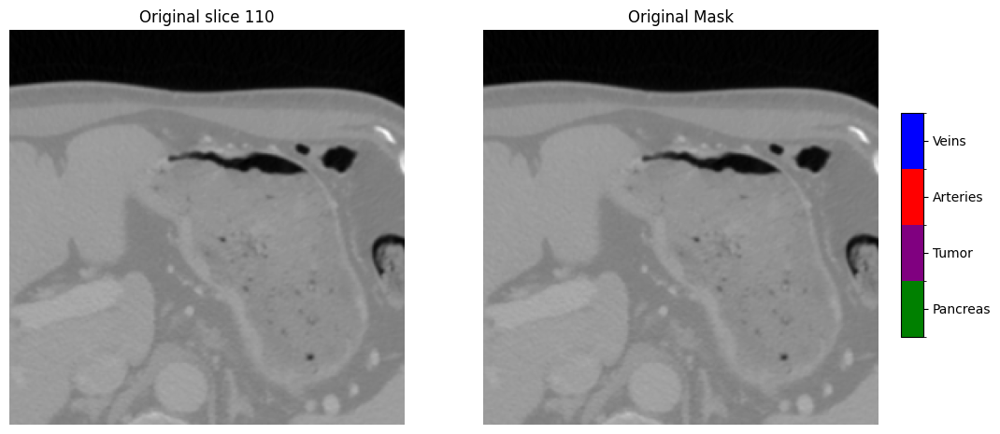

In [23]:
test_preprocessing('rtum35')

In [24]:
def visualize_processed_patient(data_dir):
    images = [os.path.join(data_dir, 'images', i) for i in os.listdir(os.path.join(data_dir, 'images'))]
    masks = [os.path.join(data_dir, 'masks', i) for i in os.listdir(os.path.join(data_dir, 'masks'))]
    for i, (img, msk) in enumerate(zip(images, masks)):
        image = np.load(img)
        mask = np.array(Image.open(msk).convert("L"))
        mask_overlay = np.where(mask > 0, mask, np.nan)

        # Visualize
        fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    
        # Original
        axes[0].imshow(image, cmap='gray')
        axes[0].set_title(f'Original slice {i}')
        axes[0].axis('off')
    
        # Original mask
        axes[1].imshow(image, cmap="gray")
        axes[1].imshow(mask_overlay, cmap=cmap, norm=norm, alpha=0.8)
        axes[1].set_title("Original Mask")
        axes[1].axis('off')
    
        # Add classes colorbar
        cbar_ax = fig.add_axes([0.92, 0.3, 0.02, 0.4])
        colorbar = plt.colorbar(plt.cm.ScalarMappable(norm=norm, cmap=cmap), cax=cbar_ax)
        colorbar.set_ticks([1, 2, 3, 4])
        colorbar.set_ticklabels(['Pancreas', 'Tumor', 'Arteries', 'Veins'])
    
        plt.show()

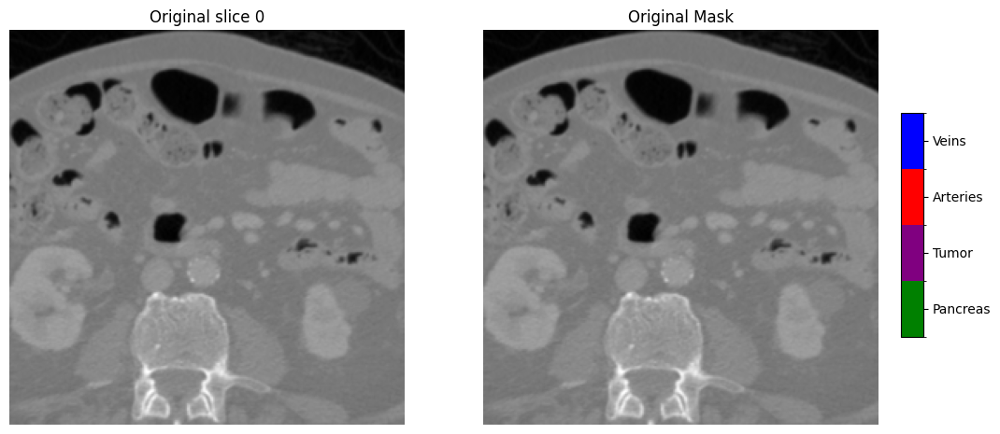

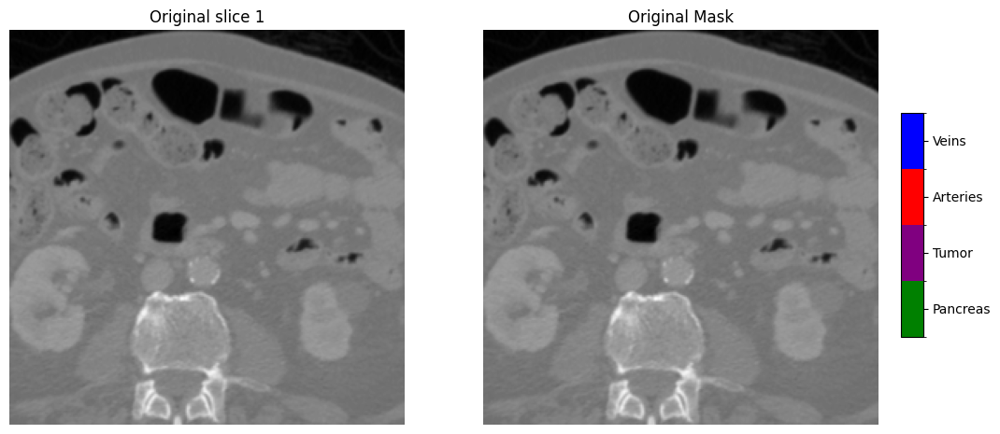

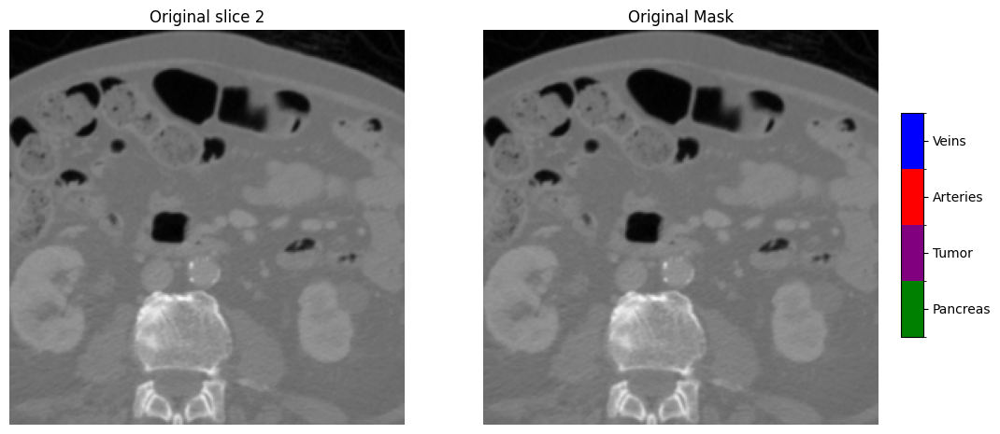

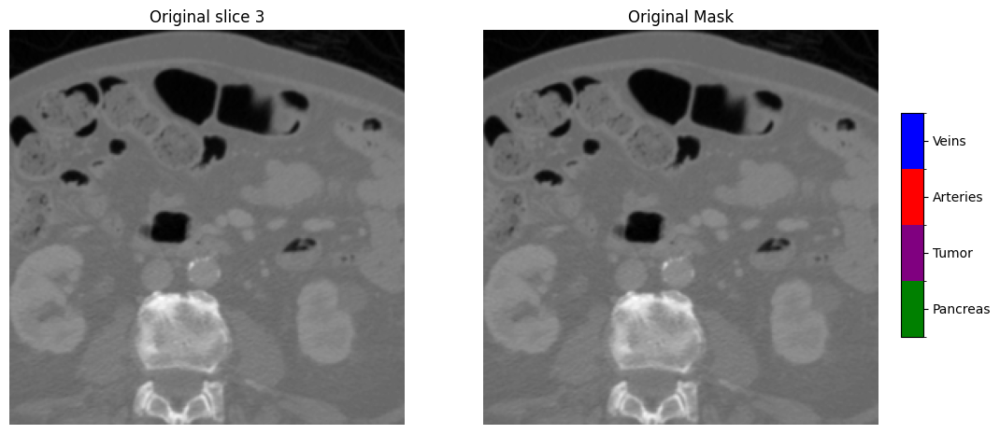

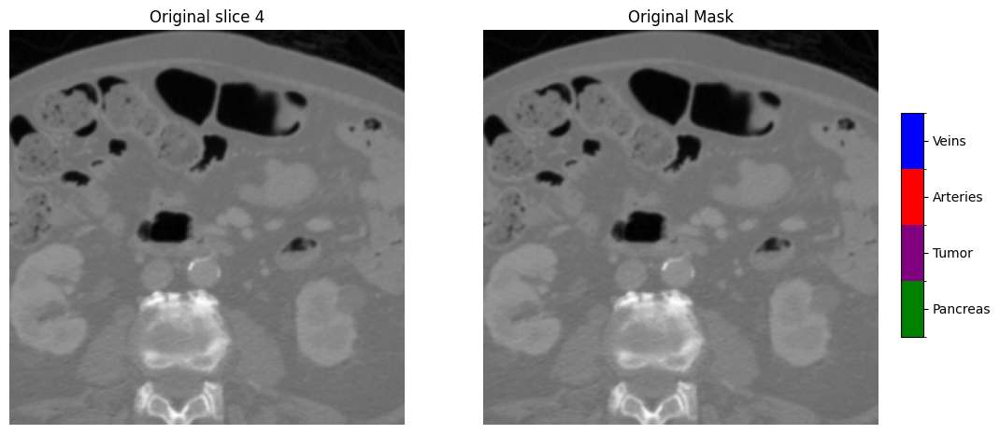

...

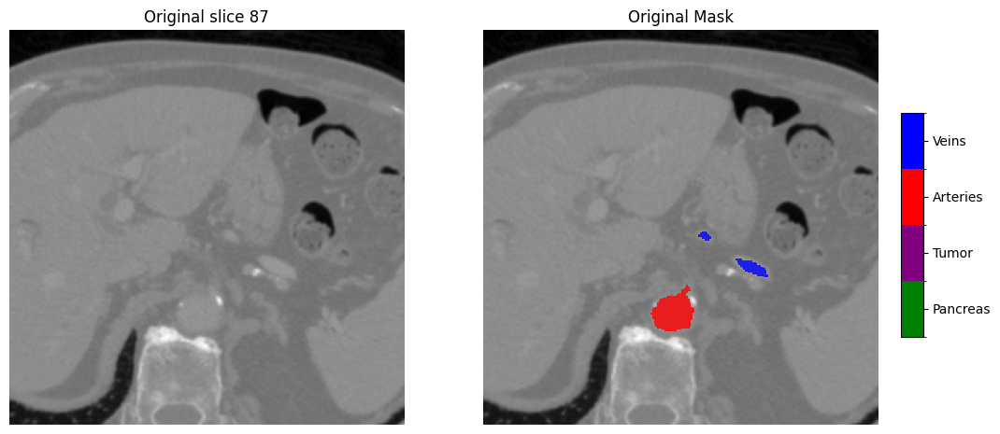

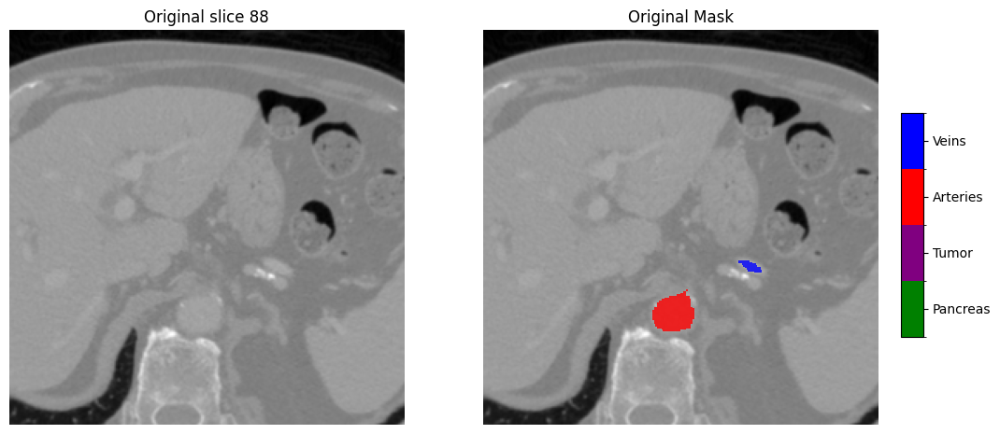

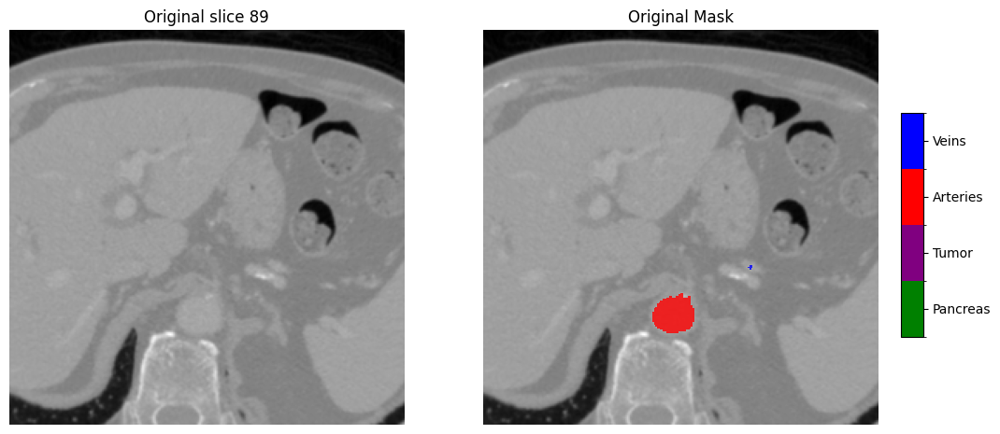

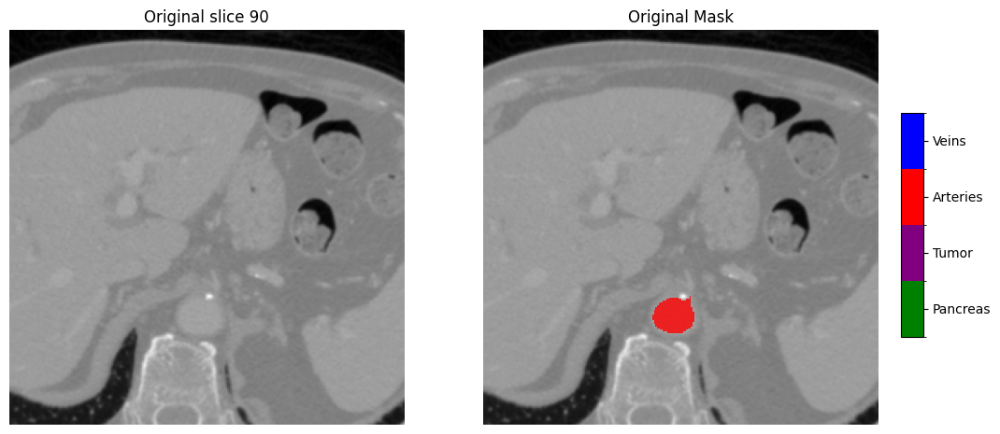

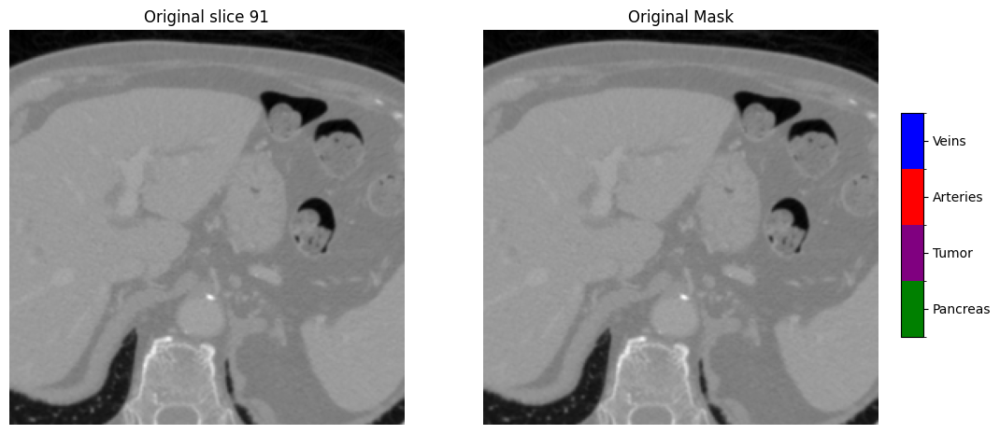

In [26]:
visualize_processed_patient('data/processed/2d_res/train')